<a href="https://colab.research.google.com/github/Yash-Bhar/weather-prediction-GNN-transformer/blob/main/Capstone_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install azure-storage-blob fsspec xarray netCDF4 h5netcdf tensorflow gcsfs lightgbm
%pip install --upgrade https://github.com/deepmind/graphcast/archive/master.zip


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.4/44.4 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 407.0/407.0 kB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.3/9.3 MB 116.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.7/210.7 kB 20.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 77.5 MB/s eta 0:00:00
     \ 1.7 MB 3.6 MB/s 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 122.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.3/172.3 kB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 373.8/373.8 kB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.6/90.6 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 541.1/541.1 kB 43.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 712.4/712.4 kB 51.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0

In [ ]:
!pip install adlfs torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.8/41.8 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.3/55.3 kB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 186.1/186.1 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.4/115.4 kB 6.9 MB/s eta 0:00:00


In [ ]:
# Standard library imports
import datetime
import math
from typing import Optional
from IPython.display import HTML
from IPython import display

# Third-party numerical/scientific computing
import numpy as np
import pandas as pd
import dask
import zarr
import lightgbm

# Visualization
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import animation
import matplotlib.colors
import cartopy.crs as ccrs
from tqdm import tqdm

# Cloud storage/filesystems
import fsspec
import gcsfs
from adlfs import AzureBlobFileSystem
from google.cloud import storage

# Machine learning
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch_geometric.nn import GCNConv, global_mean_pool
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error


# JAX and related
import jax
import haiku as hk

# Xarray and related
import xarray
import xarray as xr
from graphcast import (
    rollout,
    xarray_jax,
    normalization,
    checkpoint,
    data_utils,
    xarray_tree,
    gencast,
    denoiser,
    nan_cleaning
)

# Widgets
import ipywidgets as widgets

##Loading ERA5 Dataset

In [ ]:
ds = xr.open_zarr(
    'gs://gcp-public-data-arco-era5/ar/1959-2022-wb13-6h-0p25deg-chunk-1.zarr-v2',
    chunks=None,
    storage_options=dict(token='anon'),
    consolidated=True
)


In [ ]:
# Load dataset (assuming it's already loaded as ds)
# Subset based on India's latitude and longitude range
#india_ds_temp = ds.sortby("latitude")
india_ds_temp = ds.sel(latitude=slice(38, 6), longitude=slice(68, 98))

# Ensure time coordinate is in datetime format
india_ds_temp["time"] = xr.decode_cf(india_ds_temp).time  # Convert time to datetime if needed

# Filter dataset from 2021 onwards
india_ds = india_ds_temp.sel(time=slice("2021-01-01", None))

# Print the filtered dataset to check dimensions
print(india_ds)
sample = india_ds['10m_u_component_of_wind']  # Get the first sample
input_size = sample.shape[1]
print(input_size)  # For input features
#print(sample.y.shape)  # For labels, if applicable


<xarray.Dataset> Size: 9GB
Dimensions:                                           (time: 1460,
                                                       latitude: 129,
                                                       longitude: 121, level: 13)
Coordinates:
  * latitude                                          (latitude) float32 516B ...
  * level                                             (level) int64 104B 50 ....
  * longitude                                         (longitude) float32 484B ...
  * time                                              (time) datetime64[ns] 12kB ...
Data variables: (12/36)
    10m_u_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    10m_v_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    2m_temperature                                    (time, latitude, longitude) float32 91MB ...
    angle_of_sub_gridscale_orography                  (latitude, longitude) float32 62kB 

In [ ]:
# Extract time components
time_values = india_ds["time"].dt
hour = time_values.hour
day_of_year = time_values.dayofyear
total_hours = 24
total_days = 365  # Ignoring leap years for simplicity

# Compute sine and cosine transformations
india_ds["sin_time"] = np.sin(2 * np.pi * hour / total_hours)
india_ds["cos_time"] = np.cos(2 * np.pi * hour / total_hours)
india_ds["sin_date"] = np.sin(2 * np.pi * day_of_year / total_days)
india_ds["cos_date"] = np.cos(2 * np.pi * day_of_year / total_days)

In [ ]:
# Ensure only variables with 'time' dimension are updated
if "time" in india_ds.dims:
    india_ds_temp = india_ds.assign_coords(time=("time", india_ds["time"].dt.hour.data))


##Normalising Dataset using Min Max algo


In [ ]:
ds_temp = india_ds_temp

# Variables to normalize (modify based on importance)
variables_to_normalize = [
    var  for var in india_ds_temp
]

# Simple Min-Max normalization function
def normalize_minmax(data):
    min_val = np.nanmin(data)  # Ignore NaN values
    max_val = np.nanmax(data)
    return (data - min_val) / (max_val - min_val + 1e-8)  # Small value to avoid division by zero

# Apply normalization directly to the dataset (in-place)
for var in variables_to_normalize:
    if var in ds_temp:
        ds_temp[var].values = normalize_minmax(ds_temp[var].values)


ds_temp


<xarray.Dataset> Size: 9GB
Dimensions:                                           (time: 1460,
                                                       latitude: 129,
                                                       longitude: 121, level: 13)
Coordinates:
  * latitude                                          (latitude) float32 516B ...
  * level                                             (level) int64 104B 50 ....
  * longitude                                         (longitude) float32 484B ...
  * time                                              (time) int64 12kB 0 ... 18
Data variables: (12/40)
    10m_u_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    10m_v_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    2m_temperature                                    (time, latitude, longitude) float32 91MB ...
    angle_of_sub_gridscale_orography                  (latitude, longitude) float32 62kB ...
    anisotropy_of_sub_gridscale_orography             (latitude, longitude) float32 62kB ...
    geopotential                                      (time, level, latitude, longitude) float32 1GB ...
    ...                                                ...
    v_component_of_wind                               (time, level, latitude, longitude) float32 1GB ...
    vertical_velocity                                 (time, level, latitude, longitude) float32 1GB ...
    sin_time                                          (time) float64 12kB 0.5...
    cos_time                                          (time) float64 12kB 1.0...
    sin_date                                          (time) float64 12kB 0.5...
    cos_date                                          (time) float64 12kB 0.9...

####Saving normalised data

In [ ]:
ds_temp.to_netcdf("dataset.nc")

##Azure Connectivity

In [ ]:
# Azure Storage details
ACCOUNT_NAME = "capstonedataforvit"
#Make sure to change the SAS_TOKEN since it has an expiry
SAS_TOKEN = "?sp=r&st=2025-04-19T10:03:41Z&se=2025-04-26T18:03:41Z&spr=https&sv=2024-11-04&sr=b&sig=eVcGG9%2FhDc1NXVsi19hLBItMSxc6ZfkpwQAR7PrhzXY%3D"
CONTAINER_NAME = "dataforcapstone"
BLOB_NAME = "dataset.nc"

# Open the .nc file directly using xarray with fsspec
ds = xr.open_dataset(f"az://{CONTAINER_NAME}/{BLOB_NAME}",
                     engine="h5netcdf",
                     backend_kwargs={'storage_options': {"account_name": ACCOUNT_NAME, "sas_token": SAS_TOKEN}})


In [ ]:
print(ds)

<xarray.Dataset> Size: 9GB
Dimensions:                                           (time: 1460,
                                                       latitude: 129,
                                                       longitude: 121, level: 13)
Coordinates:
  * latitude                                          (latitude) float32 516B ...
  * level                                             (level) int64 104B 50 ....
  * longitude                                         (longitude) float32 484B ...
  * time                                              (time) int64 12kB 0 ... 18
Data variables: (12/40)
    10m_u_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    10m_v_component_of_wind                           (time, latitude, longitude) float32 91MB ...
    2m_temperature                                    (time, latitude, longitude) float32 91MB ...
    angle_of_sub_gridscale_orography                  (latitude, longitude) float32 62kB ...


## TO find importance Matrix using Random Forest

In [ ]:
# Function to flatten 2D, 3D, or 4D variables to 2D
def flatten_variable(da):
    if da.ndim == 2:
        return da.values.flatten()
    elif da.ndim == 3:
        return da.mean(dim='time').values.flatten()
    elif da.ndim == 4:
        return da.mean(dim=['time', 'level']).values.flatten()

# Prepare the data
X = {}
for var in ds.data_vars:
    if var != 'temperature':
        X[var] = flatten_variable(ds[var])

# Flatten the target variable (temperature)
y = ds['temperature'].mean(dim=['time', 'level']).values.flatten()

# Create a DataFrame
df = pd.DataFrame(X)

# Calculate correlation with temperature
correlations = df.corrwith(pd.Series(y))
top_corr_features = correlations.abs().sort_values(ascending=False).index.tolist()

# Select top correlated features
X_selected = df[top_corr_features]

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train a Random Forest model
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train_scaled, y_train)

# Get feature importances
importances = pd.Series(rf.feature_importances_, index=X_selected.columns).sort_values(ascending=False)

# Print top 5 most important features

importances


In [ ]:
# Function to flatten 2D, 3D, or 4D variables to 2D
def flatten_variable(da):
    if da.ndim == 2:
        return da.values.flatten()
    elif da.ndim == 3:
        return da.mean(dim='time').values.flatten()
    elif da.ndim == 4:
        return da.mean(dim=['time', 'level']).values.flatten()
# Prepare the data
X = {}
for var in ds.data_vars:
    if var != 'temperature':
        X[var] = flatten_variable(ds[var])
temp = ['sin_time', 'cos_time', 'sin_date', 'cos_date']
for a in temp:
  if a in X:
    del X[a]

##Using LightGBM

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000542 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 12487, number of used features: 15
[LightGBM] [Info] Start training from score 0.488445
Top 5 most important features for predicting temperature:
mean_sea_level_pressure         475
toa_incident_solar_radiation    328
total_cloud_cover               202
u_component_of_wind             195
2m_temperature                  191
dtype: int32


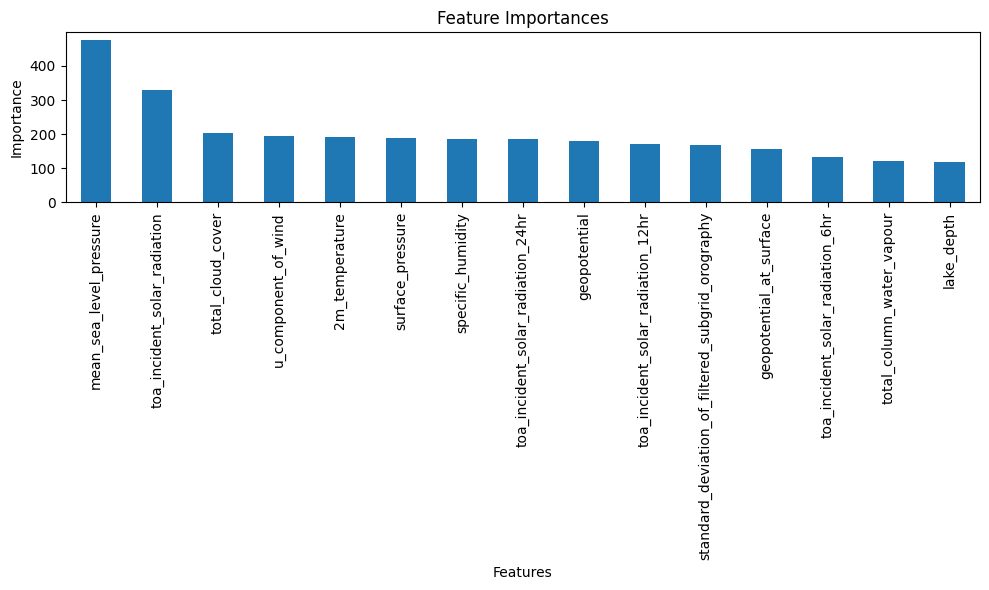

In [ ]:
# Flatten and aggregate the target variable (temperature)
y = np.array([ds['temperature'].mean(dim=['time', 'level']).values.flatten(),
              ds['temperature'].std(dim=['time', 'level']).values.flatten()]).T

# Create a DataFrame
df = pd.DataFrame({k: v.ravel() for k, v in X.items() if v.ndim == 1})
for k, v in X.items():
    if v.ndim > 1:
        df[f'{k}_mean'] = v[:, 0]
        df[f'{k}_std'] = v[:, 1]

# Handle NaN values in the DataFrame before calculating mutual information
df = df.fillna(df.mean())  # Replace NaN with the mean of each column

# Calculate Mutual Information scores
from sklearn.feature_selection import mutual_info_regression  # Import necessary function
mi_scores = mutual_info_regression(df, y[:, 0])
mi_features = pd.Series(mi_scores, index=df.columns).sort_values(ascending=False)

# Select top features based on Mutual Information
top_mi_features = mi_features.head(15).index.tolist()

# Split the data
X_selected = df[top_mi_features]
X_train, X_test, y_train, y_test = train_test_split(X_selected, y[:, 0], test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train a LightGBM model
from lightgbm import LGBMRegressor  # Import necessary class
gbm = LGBMRegressor(n_estimators=100, random_state=42)
gbm.fit(X_train_scaled, y_train)

# Get feature importances
importances = pd.Series(gbm.feature_importances_, index=X_selected.columns).sort_values(ascending=False)

# Print top 5 most important features
print("Top 5 most important features for predicting temperature:")
print(importances.head())

# Print feature importance plot
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
importances.plot(kind='bar')
plt.title('Feature Importances')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.tight_layout()
plt.show()

###Animation Trial

In [ ]:
def select(
    ds: xarray.Dataset,
    variable: str,
    level: Optional[int] = None,
    max_steps: Optional[int] = None
    ) -> xarray.Dataset:
  data = ds[variable]
  if "batch" in data.dims:
    data = data.isel(batch=0)
  if max_steps is not None and "time" in data.sizes and max_steps < data.sizes["time"]:
    data = data.isel(time=range(0, max_steps))
  if level is not None and "level" in data.coords:
    data = data.sel(level=level)
  return data

def scale(
    ds: xarray.Dataset,
    center: Optional[float] = None,
    robust: bool = False,
    ) -> tuple[xarray.Dataset, matplotlib.colors.Normalize, str]:
  vmin = np.nanpercentile(ds, (2 if robust else 0))
  vmax = np.nanpercentile(ds, (98 if robust else 100))
  if center is not None:
    diff = max(vmax - center, center - vmin)
    vmin = center - diff
    vmax = center + diff
  return (ds, matplotlib.colors.Normalize(vmin, vmax),
          ("RdBu_r" if center is not None else "viridis"))

def plot_data(
    ds: dict[str, xarray.Dataset],
    fig_title: str,
    plot_size: float = 5,
    robust: bool = False,
    cols: int = 4
    ) -> tuple[xarray.Dataset, matplotlib.colors.Normalize, str]:

  first_data = next(iter(ds.values()))[0]
  max_steps = first_data.sizes.get("time", 1)
  assert all(max_steps == d.sizes.get("time", 1) for d, _, _ in ds.values())

  cols = min(cols, len(ds))
  rows = math.ceil(len(ds) / cols)
  figure = plt.figure(figsize=(plot_size * 2 * cols,
                               plot_size * rows))
  figure.suptitle(fig_title, fontsize=16)
  figure.subplots_adjust(wspace=0, hspace=0)
  figure.tight_layout()

  images = []
  for i, (title, (plot_data, norm, cmap)) in enumerate(ds.items()):
    ax = figure.add_subplot(rows, cols, i+1)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_title(title)
    im = ax.imshow(
        plot_data.isel(time=0, missing_dims="ignore"), norm=norm,
        origin="lower", cmap=cmap)
    plt.colorbar(
        mappable=im,
        ax=ax,
        orientation="vertical",
        pad=0.02,
        aspect=16,
        shrink=0.75,
        cmap=cmap,
        extend=("both" if robust else "neither"))
    images.append(im)

  def update(frame):
    if "time" in first_data.dims:
      td = datetime.timedelta(microseconds=first_data["time"][frame].item() / 1000)
      figure.suptitle(f"{fig_title}, {td}", fontsize=16)
    else:
      figure.suptitle(fig_title, fontsize=16)
    for im, (plot_data, norm, cmap) in zip(images, ds.values()):
      im.set_data(plot_data.isel(time=frame, missing_dims="ignore"))

  ani = animation.FuncAnimation(
      fig=figure, func=update, frames=max_steps, interval=250)
  plt.close(figure.number)
  return HTML(ani.to_jshtml())

In [ ]:
plot_example_variable = widgets.Dropdown(
    options=ds.data_vars.keys(),
    value="2m_temperature",
    description="Variable")
plot_example_level = widgets.Dropdown(
    options=ds.coords["level"].values,
    value=500,
    description="Level")
plot_example_robust = widgets.Checkbox(value=True, description="Robust")
plot_example_max_steps = widgets.IntSlider(
    min=1, max=ds.dims["time"], value=ds.dims["time"],
    description="Max steps")

widgets.VBox([
    plot_example_variable,
    plot_example_level,
    plot_example_robust,
    plot_example_max_steps,
    widgets.Label(value="Run the next cell to plot the data. Rerunning this cell clears your selection.")
])

<ipython-input-4-02a83bb63cab>:11: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  min=1, max=ds.dims["time"], value=ds.dims["time"],


In [ ]:
# @title Plot example data

plot_size = 7

data = {
    " ": scale(select(ds, plot_example_variable.value, plot_example_level.value, plot_example_max_steps.value),
              robust=plot_example_robust.value),
}
fig_title = plot_example_variable.value
if "level" in ds[plot_example_variable.value].coords:
  fig_title += f" at {plot_example_level.value} hPa"

plot_data(data, fig_title, plot_size, plot_example_robust.value)


In [ ]:
ds = ds.drop([
    "10m_u_component_of_wind",
    "10m_v_component_of_wind",
    "v_component_of_wind",
    "standard_deviation_of_orography",
    "slope_of_sub_gridscale_orography",
    "low_vegetation_cover",
    "high_vegetation_cover",
    "vertical_velocity",
    "anisotropy_of_sub_gridscale_orography",
    "angle_of_sub_gridscale_orography",
    "land_sea_mask",
    "lake_cover",
    "type_of_high_vegetation",
    "type_of_low_vegetation",
    "soil_type",
    "sea_surface_temperature",
    "sea_ice_cover",
    "sin_time",
    "cos_time",
    "sin_date",
    "cos_date"]
)

<ipython-input-5-d02152a52c93>:1: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  ds = ds.drop([


###Model_Backup

In [ ]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load and prepare temperature data
def load_and_prepare_data(ds_path, variable='temperature', seq_len=6, pred_len=1):
    # Load the dataset


    # Select temperature variable at 850 hPa
    level_idx = np.where(ds.level.values == 850)[0][0]
    temp_data = ds[variable].values[:, level_idx, :, :]  # shape: (time, lat, lon)

    # Normalize data
    temp_mean = temp_data.mean()
    temp_std = temp_data.std()
    temp_data = (temp_data - temp_mean) / temp_std

    # Create sequences for training
    X, y = [], []
    for i in range(len(temp_data) - seq_len - pred_len):
        X.append(temp_data[i:i+seq_len])
        y.append(temp_data[i+seq_len:i+seq_len+pred_len])

    X = np.array(X)  # shape: (samples, seq_len, lat, lon)
    y = np.array(y)  # shape: (samples, pred_len, lat, lon)

    # Create graph structure (fixed grid)
    lat_size, lon_size = temp_data.shape[1], temp_data.shape[2]
    edge_index = create_grid_edges(lat_size, lon_size)

    # Split into train and test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    return X_train, X_test, y_train, y_test, edge_index, temp_mean, temp_std, ds

def create_grid_edges(lat_size, lon_size):
    # Create edges for a 2D grid graph
    edge_index = []
    for i in range(lat_size):
        for j in range(lon_size):
            node = i * lon_size + j
            # Connect to right neighbor
            if j < lon_size - 1:
                edge_index.append([node, node + 1])
                edge_index.append([node + 1, node])
            # Connect to bottom neighbor
            if i < lat_size - 1:
                edge_index.append([node, node + lon_size])
                edge_index.append([node + lon_size, node])

    return torch.tensor(edge_index, dtype=torch.long).t().contiguous().to(device)

class GNNBlock(nn.Module):
    def __init__(self, input_dim, hidden_dim):
        super().__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, hidden_dim)
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, x, edge_index, batch=None):
        x = F.relu(self.conv1(x, edge_index))
        x = F.relu(self.conv2(x, edge_index))
        if batch is not None:
            x = global_mean_pool(x, batch)
        x = self.linear(x)
        return x

class TransformerBlock(nn.Module):
    def __init__(self, embed_dim, num_heads, hidden_dim):
        super().__init__()
        self.attention = nn.MultiheadAttention(embed_dim, num_heads)
        self.norm1 = nn.LayerNorm(embed_dim)
        self.mlp = nn.Sequential(
            nn.Linear(embed_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, embed_dim)
        )
        self.norm2 = nn.LayerNorm(embed_dim)

    def forward(self, x):
        attn_output, _ = self.attention(x, x, x)
        x = self.norm1(x + attn_output)
        mlp_output = self.mlp(x)
        x = self.norm2(x + mlp_output)
        return x

class GraphCastGNN(nn.Module):
    def __init__(self, input_dim=1, gnn_hidden_dim=64, embed_dim=128, num_heads=4, num_layers=2):
        super().__init__()
        self.gnn_hidden_dim = gnn_hidden_dim
        self.embed_dim = embed_dim

        # GNN part
        self.gnn = GNNBlock(input_dim, gnn_hidden_dim)

        # Transformer part
        self.transformer = nn.Sequential(
            *[TransformerBlock(embed_dim, num_heads, gnn_hidden_dim) for _ in range(num_layers)]
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(embed_dim, gnn_hidden_dim),
            nn.ReLU(),
            nn.Linear(gnn_hidden_dim, 129 * 121)  # Output size matches spatial dimensions
        )

    def forward(self, x, edge_index):
        # x shape: (batch_size, seq_len, lat, lon)
        batch_size, seq_len, lat_size, lon_size = x.size()

        # Reshape for GNN processing (flatten spatial and sequence dimensions)
        x = x.view(batch_size * seq_len * lat_size * lon_size, 1)

        # Create batch vector
        batch = torch.arange(batch_size * seq_len).repeat_interleave(lat_size * lon_size).to(device)

        # GNN processing
        x = self.gnn(x, edge_index, batch)  # (batch*seq_len, gnn_hidden_dim)

        # Reshape for transformer
        x = x.view(batch_size, seq_len, self.gnn_hidden_dim)
        x = x.permute(1, 0, 2)  # (seq_len, batch, gnn_hidden_dim)

        # Project to embed_dim
        x = F.relu(nn.Linear(self.gnn_hidden_dim, self.embed_dim)(x))

        # Transformer processing
        x = self.transformer(x)

        # Get last timestep
        x = x[-1]  # (batch, embed_dim)

        # Decode to prediction
        x = self.decoder(x)

        # Reshape to spatial dimensions
        x = x.view(batch_size, 1, lat_size, lon_size)

        return x

def create_dataloader(X, y, edge_index, batch_size=32):
    dataset = []
    for i in range(len(X)):
        # Create a Data object for each sample
        x_tensor = torch.FloatTensor(X[i]).view(-1, 1).to(device)
        y_tensor = torch.FloatTensor(y[i]).view(-1, 1).to(device)

        data = Data(
            x=x_tensor,
            edge_index=edge_index,
            y=y_tensor,
            num_nodes=x_tensor.size(0)
        )
        dataset.append(data)
    return DataLoader(dataset, batch_size=batch_size, shuffle=True)
"""

def train_model(model, train_loader, test_loader, epochs=10):
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    criterion = nn.MSELoss()

    best_loss = float('inf')

    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            optimizer.zero_grad()

            # Get the batch data
            x = batch.x
            edge_index = batch.edge_index
            y = batch.y

            # Reshape input to (batch_size, seq_len, lat, lon)
            batch_size = len(torch.unique(batch.batch))
            seq_len = 6  # Hardcoded based on SEQ_LEN
            x = x.view(batch_size, seq_len, 129, 121)

            outputs = model(x, edge_index)
            loss = criterion(outputs, y.view(batch_size, 1, 129, 121))
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch in test_loader:
                x = batch.x
                edge_index = batch.edge_index
                y = batch.y

                batch_size = len(torch.unique(batch.batch))
                seq_len = 6  # Hardcoded based on SEQ_LEN
                x = x.view(batch_size, seq_len, 129, 121)

                outputs = model(x, edge_index)
                val_loss += criterion(outputs, y.view(batch_size, 1, 129, 121)).item()

        train_loss /= len(train_loader)
        val_loss /= len(test_loader)
        print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

        # Save best model
        if val_loss < best_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), 'best_model_gnn.pth')

    model.load_state_dict(torch.load('best_model_gnn.pth'))
    torch.save(model, 'full_model.pt')
    return model
"""

def train_model(model, train_loader, test_loader, epochs=10):
    model.to(device)  # Ensure model is on the right device
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    criterion = nn.MSELoss()

    best_loss = float('inf')

    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            optimizer.zero_grad()

            # Get the batch data and move to device
            x = batch.x.to(device)
            edge_index = batch.edge_index.to(device)
            y = batch.y.to(device)

            # Reshape input to (batch_size, seq_len, lat, lon)
            batch_size = len(torch.unique(batch.batch))
            seq_len = 6  # Hardcoded based on SEQ_LEN
            x = x.view(batch_size, seq_len, 129, 121)

            outputs = model(x, edge_index)
            loss = criterion(outputs, y.view(batch_size, 1, 129, 121))
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch in test_loader:
                x = batch.x.to(device)
                edge_index = batch.edge_index.to(device)
                y = batch.y.to(device)

                batch_size = len(torch.unique(batch.batch))
                seq_len = 6  # Hardcoded based on SEQ_LEN
                x = x.view(batch_size, seq_len, 129, 121)

                outputs = model(x, edge_index)
                val_loss += criterion(outputs, y.view(batch_size, 1, 129, 121)).item()

        train_loss /= len(train_loader)
        val_loss /= len(test_loader)
        print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

        # Save best model
        if val_loss < best_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), f'best_model_gnn{epoch+1}.pth')

    model.load_state_dict(torch.load('best_model_gnn.pth'))
    torch.save(model, 'full_model.pt')
    return model



def evaluate_and_plot(model, test_loader, ds, temp_mean, temp_std, num_samples=3):
    model.eval()
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in test_loader:
            x = batch.x
            edge_index = batch.edge_index

            batch_size = len(torch.unique(batch.batch))
            seq_len = 6  # Hardcoded based on SEQ_LEN
            x = x.view(batch_size, seq_len, 129, 121)

            pred = model(x, edge_index)
            predictions.append(pred.to(device).numpy())
            actuals.append(batch.y.view(batch_size, 1, 129, 121).to(device).numpy())

    predictions = np.concatenate(predictions)
    actuals = np.concatenate(actuals)

    # Denormalize
    predictions = predictions * temp_std + temp_mean
    actuals = actuals * temp_std + temp_mean

    # Save results
    np.save('gnn_predictions.npy', predictions)
    np.save('gnn_actuals.npy', actuals)

    # Plot heatmaps
    lat = ds.latitude.values
    lon = ds.longitude.values

    for i in range(min(num_samples, len(predictions))):
        plt.figure(figsize=(16, 6))

        plt.subplot(1, 2, 1)
        plt.contourf(lon, lat, actuals[i, 0], cmap='coolwarm', levels=20)
        plt.colorbar(label='Temperature (K)')
        plt.title(f"Actual Temperature at 850 hPa - Sample {i+1}")

        plt.subplot(1, 2, 2)
        plt.contourf(lon, lat, predictions[i, 0], cmap='coolwarm', levels=20)
        plt.colorbar(label='Temperature (K)')
        plt.title(f"Predicted Temperature at 850 hPa - Sample {i+1}")

        plt.tight_layout()
        plt.savefig(f'gnn_temperature_comparison_{i+1}.png')
        plt.show()

# Main execution
if __name__ == "__main__":
    # Parameters
    SEQ_LEN = 6
    PRED_LEN = 1
    BATCH_SIZE = 32
    EPOCHS = 3

    # Load data
    print("Loading temperature data...")
    X_train, X_test, y_train, y_test, edge_index, temp_mean, temp_std, ds = load_and_prepare_data(
        ds,
        variable='temperature',
        seq_len=SEQ_LEN,
        pred_len=PRED_LEN
    )

    # Create dataloaders
    train_loader = create_dataloader(X_train, y_train, edge_index, BATCH_SIZE)
    test_loader = create_dataloader(X_test, y_test, edge_index, BATCH_SIZE)

    # Initialize model
    print("Initializing model...")
    model = GraphCastGNN().to(device)
    print(model)

    # Train model
    print("Training model...")
    model = train_model(model, train_loader, test_loader, EPOCHS)

    # Evaluate and plot
    print("Evaluating model...")
    evaluate_and_plot(model, test_loader, ds, temp_mean, temp_std)

    print("Training complete. Model and results saved.")

Using device: cuda
Loading temperature data...
Initializing model...
GraphCastGNN(
  (gnn): GNNBlock(
    (conv1): GCNConv(1, 64)
    (conv2): GCNConv(64, 64)
    (linear): Linear(in_features=64, out_features=64, bias=True)
  )
  (transformer): Sequential(
    (0): TransformerBlock(
      (attention): MultiheadAttention(
        (out_proj): NonDynamicallyQuantizableLinear(in_features=128, out_features=128, bias=True)
      )
      (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
      (mlp): Sequential(
        (0): Linear(in_features=128, out_features=64, bias=True)
        (1): ReLU()
        (2): Linear(in_features=64, out_features=128, bias=True)
      )
      (norm2): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
    )
    (1): TransformerBlock(
      (attention): MultiheadAttention(
        (out_proj): NonDynamicallyQuantizableLinear(in_features=128, out_features=128, bias=True)
      )
      (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
   

Epoch 1:   0%|          | 0/37 [00:00<?, ?it/s]


RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu! (when checking argument for argument mat2 in method wrapper_CUDA_mm)

#Model Training

Using device: cuda
Loading temperature data...
Initializing model...
GraphCastGNN(
  (gnn): GNNBlock(
    (conv1): GCNConv(1, 64)
    (conv2): GCNConv(64, 64)
    (linear): Linear(in_features=64, out_features=64, bias=True)
  )
  (transformer): Sequential(
    (0): TransformerBlock(
      (attention): MultiheadAttention(
        (out_proj): NonDynamicallyQuantizableLinear(in_features=128, out_features=128, bias=True)
      )
      (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
      (mlp): Sequential(
        (0): Linear(in_features=128, out_features=64, bias=True)
        (1): ReLU()
        (2): Linear(in_features=64, out_features=128, bias=True)
      )
      (norm2): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
    )
    (1): TransformerBlock(
      (attention): MultiheadAttention(
        (out_proj): NonDynamicallyQuantizableLinear(in_features=128, out_features=128, bias=True)
      )
      (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
   

Epoch 1: 100%|██████████| 37/37 [00:10<00:00,  3.37it/s]


Epoch 1, Train Loss: 0.8019, Val Loss: 0.4123
New best model found! Val Loss: 0.4123
Model saved successfully to best_model_gnn.pth


Epoch 2: 100%|██████████| 37/37 [00:10<00:00,  3.38it/s]


Epoch 2, Train Loss: 0.2682, Val Loss: 0.2035
New best model found! Val Loss: 0.2035
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 3: 100%|██████████| 37/37 [00:10<00:00,  3.37it/s]


Epoch 3, Train Loss: 0.1905, Val Loss: 0.1849
New best model found! Val Loss: 0.1849
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 4: 100%|██████████| 37/37 [00:11<00:00,  3.36it/s]


Epoch 4, Train Loss: 0.1777, Val Loss: 0.1650
New best model found! Val Loss: 0.1650
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 5: 100%|██████████| 37/37 [00:11<00:00,  3.34it/s]


Epoch 5, Train Loss: 0.1718, Val Loss: 0.1628
New best model found! Val Loss: 0.1628
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 6: 100%|██████████| 37/37 [00:11<00:00,  3.34it/s]


Epoch 6, Train Loss: 0.1657, Val Loss: 0.1677


Epoch 7: 100%|██████████| 37/37 [00:11<00:00,  3.33it/s]


Epoch 7, Train Loss: 0.1628, Val Loss: 0.1633


Epoch 8: 100%|██████████| 37/37 [00:11<00:00,  3.31it/s]


Epoch 8, Train Loss: 0.1632, Val Loss: 0.1550
New best model found! Val Loss: 0.1550
Model saved successfully to best_model_gnn.pth


Epoch 9: 100%|██████████| 37/37 [00:11<00:00,  3.31it/s]


Epoch 9, Train Loss: 0.1621, Val Loss: 0.1621


Epoch 10: 100%|██████████| 37/37 [00:11<00:00,  3.31it/s]


Epoch 10, Train Loss: 0.1593, Val Loss: 0.1499
New best model found! Val Loss: 0.1499
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 11: 100%|██████████| 37/37 [00:11<00:00,  3.33it/s]


Epoch 11, Train Loss: 0.1580, Val Loss: 0.1520


Epoch 12: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 12, Train Loss: 0.1541, Val Loss: 0.1526


Epoch 13: 100%|██████████| 37/37 [00:11<00:00,  3.33it/s]


Epoch 13, Train Loss: 0.1592, Val Loss: 0.1648


Epoch 14: 100%|██████████| 37/37 [00:11<00:00,  3.33it/s]


Epoch 14, Train Loss: 0.1543, Val Loss: 0.1473
New best model found! Val Loss: 0.1473
Old model file removed: best_model_gnn.pth
Model saved successfully to best_model_gnn.pth


Epoch 15: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 15, Train Loss: 0.1517, Val Loss: 0.1547


Epoch 16: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 16, Train Loss: 0.1568, Val Loss: 0.1583


Epoch 17: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 17, Train Loss: 0.1508, Val Loss: 0.1606


Epoch 18: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 18, Train Loss: 0.1488, Val Loss: 0.1566


Epoch 19: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 19, Train Loss: 0.1511, Val Loss: 0.1488


Epoch 20: 100%|██████████| 37/37 [00:11<00:00,  3.32it/s]


Epoch 20, Train Loss: 0.1479, Val Loss: 0.1522
Loading best model from best_model_gnn.pth
Best model loaded successfully
Full model saved to full_model.pt
Evaluating model...


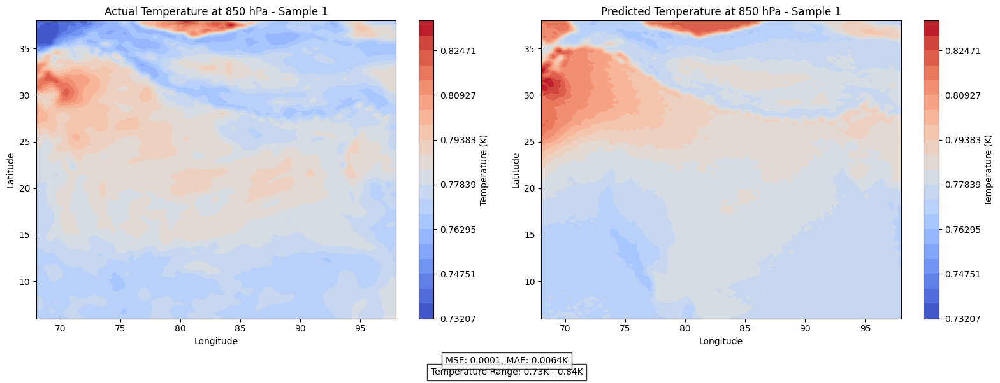

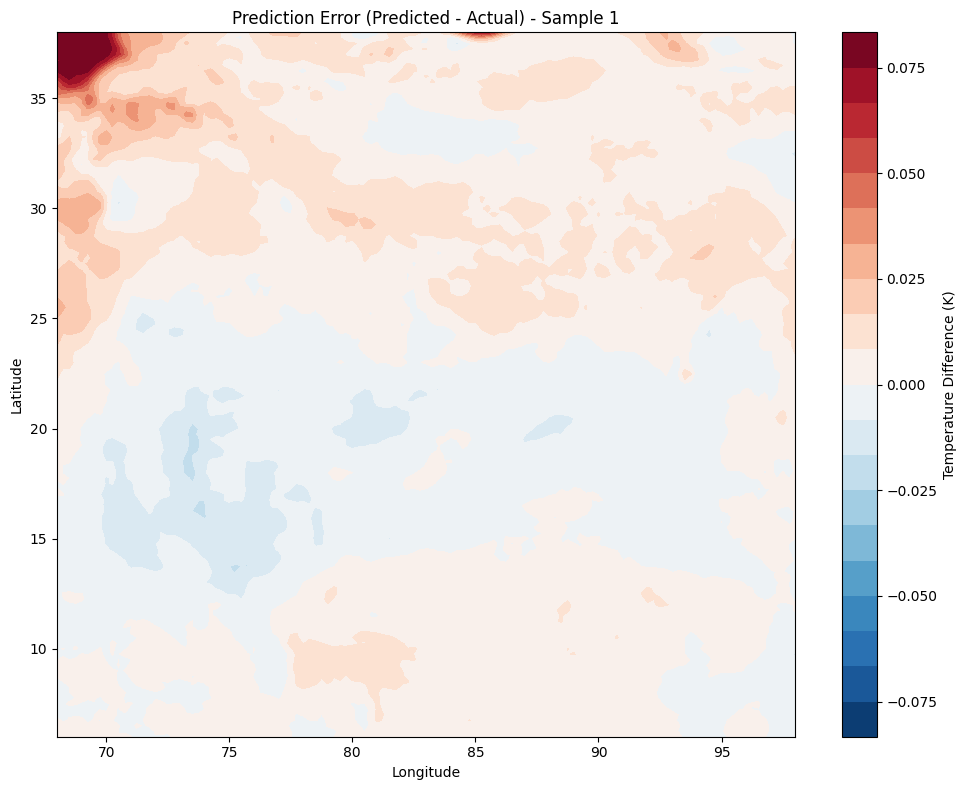

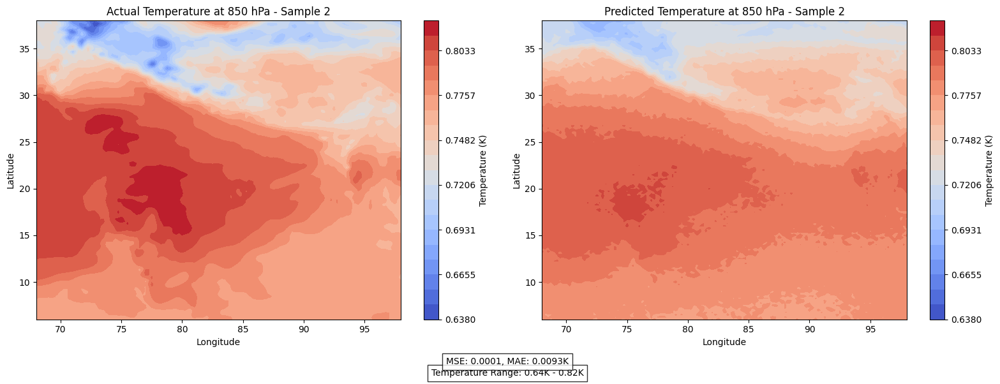

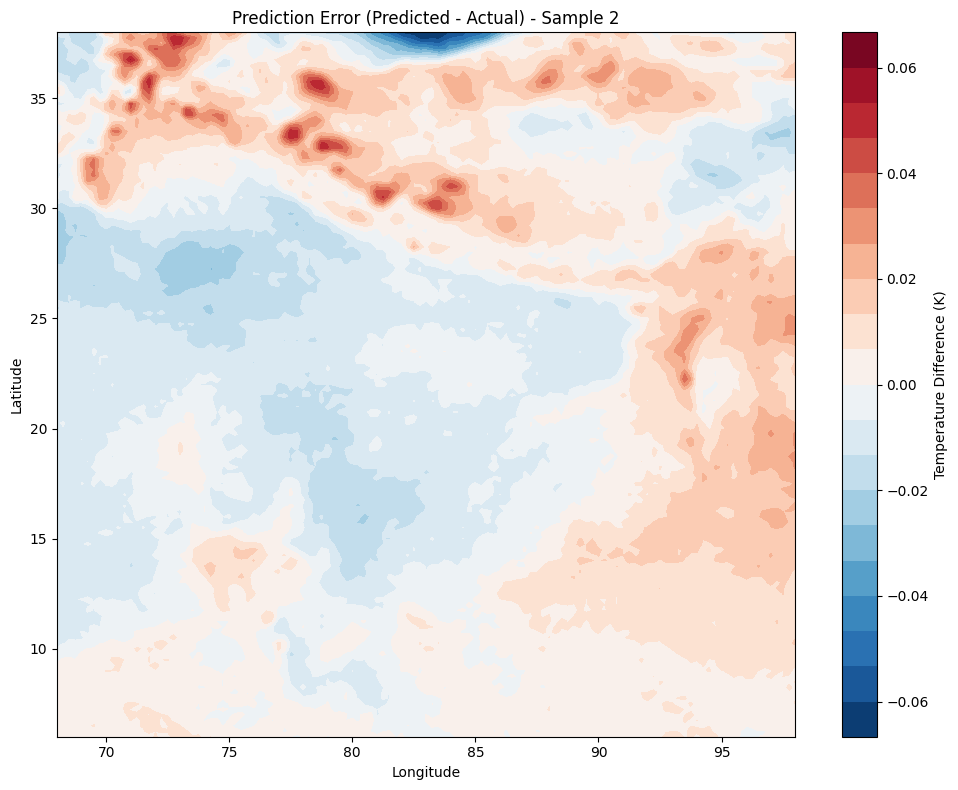

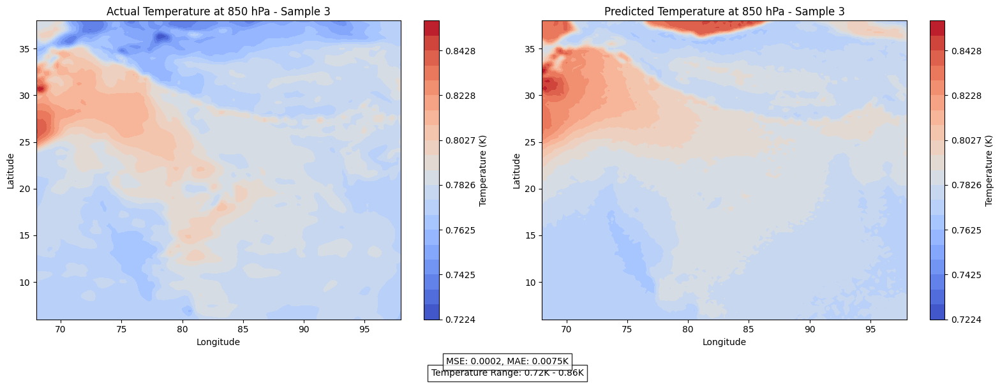

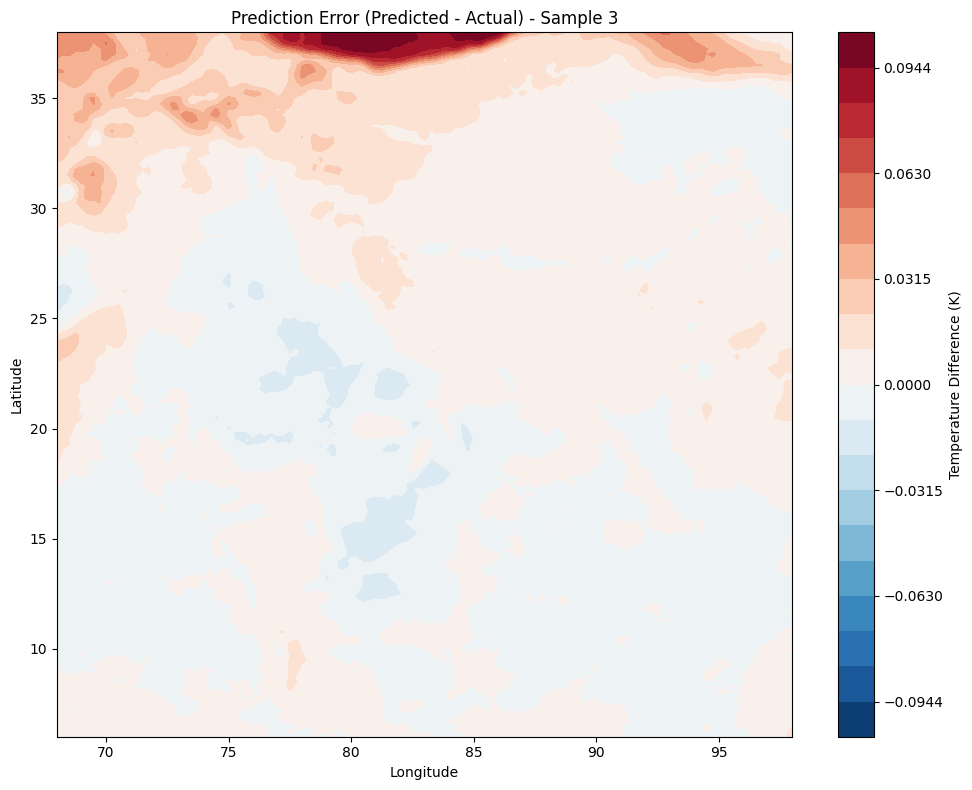

Training complete. Model and results saved.


In [ ]:
# Check if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load and prepare temperature data
def load_and_prepare_data(ds_path, variable='temperature', seq_len=6, pred_len=1):
    # Load the dataset


    # Select temperature variable at 850 hPa
    level_idx = np.where(ds.level.values == 850)[0][0]
    temp_data = ds[variable].values[:, level_idx, :, :]  # shape: (time, lat, lon)

    # Normalize data
    temp_mean = temp_data.mean()
    temp_std = temp_data.std()
    temp_data = (temp_data - temp_mean) / temp_std

    # Create sequences for training
    X, y = [], []
    for i in range(len(temp_data) - seq_len - pred_len):
        X.append(temp_data[i:i+seq_len])
        y.append(temp_data[i+seq_len:i+seq_len+pred_len])

    X = np.array(X)  # shape: (samples, seq_len, lat, lon)
    y = np.array(y)  # shape: (samples, pred_len, lat, lon)

    # Create graph structure (fixed grid)
    lat_size, lon_size = temp_data.shape[1], temp_data.shape[2]
    edge_index = create_grid_edges(lat_size, lon_size)

    # Split into train and test
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    return X_train, X_test, y_train, y_test, edge_index, temp_mean, temp_std, ds

def create_grid_edges(lat_size, lon_size):
    # Create edges for a 2D grid graph
    edge_index = []
    for i in range(lat_size):
        for j in range(lon_size):
            node = i * lon_size + j
            # Connect to right neighbor
            if j < lon_size - 1:
                edge_index.append([node, node + 1])
                edge_index.append([node + 1, node])
            # Connect to bottom neighbor
            if i < lat_size - 1:
                edge_index.append([node, node + lon_size])
                edge_index.append([node + lon_size, node])

    return torch.tensor(edge_index, dtype=torch.long).t().contiguous().to(device)

class GNNBlock(nn.Module):
    def __init__(self, input_dim, hidden_dim):
        super().__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, hidden_dim)
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, x, edge_index, batch=None):
        x = F.relu(self.conv1(x, edge_index))
        x = F.relu(self.conv2(x, edge_index))
        if batch is not None:
            x = global_mean_pool(x, batch)
        x = self.linear(x)
        return x

class TransformerBlock(nn.Module):
    def __init__(self, embed_dim, num_heads, hidden_dim):
        super().__init__()
        self.attention = nn.MultiheadAttention(embed_dim, num_heads)
        self.norm1 = nn.LayerNorm(embed_dim)
        self.mlp = nn.Sequential(
            nn.Linear(embed_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, embed_dim)
        )
        self.norm2 = nn.LayerNorm(embed_dim)

    def forward(self, x):
        attn_output, _ = self.attention(x, x, x)
        x = self.norm1(x + attn_output)
        mlp_output = self.mlp(x)
        x = self.norm2(x + mlp_output)
        return x

class GraphCastGNN(nn.Module):
    def __init__(self, input_dim=1, gnn_hidden_dim=64, embed_dim=128, num_heads=4, num_layers=2):
        super().__init__()
        self.gnn_hidden_dim = gnn_hidden_dim
        self.embed_dim = embed_dim

        # GNN part
        self.gnn = GNNBlock(input_dim, gnn_hidden_dim)

        # Transformer part
        self.transformer = nn.Sequential(
            *[TransformerBlock(embed_dim, num_heads, gnn_hidden_dim) for _ in range(num_layers)]
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(embed_dim, gnn_hidden_dim),
            nn.ReLU(),
            nn.Linear(gnn_hidden_dim, 129 * 121)  # Output size matches spatial dimensions
        )

        # Add a projection layer
        self.projection = nn.Linear(self.gnn_hidden_dim, self.embed_dim)

    def forward(self, x, edge_index):
        # x shape: (batch_size, seq_len, lat, lon)
        batch_size, seq_len, lat_size, lon_size = x.size()

        # Reshape for GNN processing (flatten spatial and sequence dimensions)
        x = x.view(batch_size * seq_len * lat_size * lon_size, 1)

        # Create batch vector - IMPORTANT: Create on the same device as x
        batch = torch.arange(batch_size * seq_len, device=x.device).repeat_interleave(lat_size * lon_size)

        # GNN processing
        x = self.gnn(x, edge_index, batch)  # (batch*seq_len, gnn_hidden_dim)

        # Reshape for transformer
        x = x.view(batch_size, seq_len, self.gnn_hidden_dim)
        x = x.permute(1, 0, 2)  # (seq_len, batch, gnn_hidden_dim)

        # Project to embed_dim - FIXED: Use the projection layer defined in __init__
        x = F.relu(self.projection(x))

        # Transformer processing
        x = self.transformer(x)

        # Get last timestep
        x = x[-1]  # (batch, embed_dim)

        # Decode to prediction
        x = self.decoder(x)

        # Reshape to spatial dimensions
        x = x.view(batch_size, 1, lat_size, lon_size)

        return x

def create_dataloader(X, y, edge_index, batch_size=32):
    dataset = []
    for i in range(len(X)):
        # Create tensors first (without moving to device)
        x_tensor = torch.FloatTensor(X[i]).view(-1, 1)
        y_tensor = torch.FloatTensor(y[i]).view(-1, 1)

        # Create a Data object for each sample (PyTorch Geometric will handle device placement)
        data = Data(
            x=x_tensor,
            edge_index=edge_index,
            y=y_tensor,
            num_nodes=x_tensor.size(0)
        )
        dataset.append(data)

    # Let the DataLoader handle the device placement
    return DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Modified train_model function with better file handling
def train_model(model, train_loader, test_loader, epochs=10):
    model.to(device)  # Ensure model is on the right device
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    criterion = nn.MSELoss()

    best_loss = float('inf')
    model_save_path = 'best_model_gnn.pth'
    full_model_path = 'full_model.pt'

    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            optimizer.zero_grad()

            # Move all batch components to device
            x = batch.x.to(device)
            edge_index = batch.edge_index.to(device)
            y = batch.y.to(device)
            batch_tensor = batch.batch.to(device)

            # Reshape input to (batch_size, seq_len, lat, lon)
            batch_size = len(torch.unique(batch_tensor))
            seq_len = 6  # Hardcoded based on SEQ_LEN
            x = x.view(batch_size, seq_len, 129, 121)

            outputs = model(x, edge_index)
            loss = criterion(outputs, y.view(batch_size, 1, 129, 121))
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch in test_loader:
                # Move all batch components to device
                x = batch.x.to(device)
                edge_index = batch.edge_index.to(device)
                y = batch.y.to(device)
                batch_tensor = batch.batch.to(device)

                batch_size = len(torch.unique(batch_tensor))
                seq_len = 6  # Hardcoded based on SEQ_LEN
                x = x.view(batch_size, seq_len, 129, 121)

                outputs = model(x, edge_index)
                val_loss += criterion(outputs, y.view(batch_size, 1, 129, 121)).item()

        train_loss /= len(train_loader)
        val_loss /= len(test_loader)
        print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")

        # Save best model with improved error handling
        if val_loss < best_loss:
            best_loss = val_loss
            print(f"New best model found! Val Loss: {val_loss:.4f}")
            try:
                # Check if file exists first
                import os
                if os.path.exists(model_save_path):
                    os.remove(model_save_path)
                    print(f"Old model file removed: {model_save_path}")

                torch.save(model.state_dict(), model_save_path)
                print(f"Model saved successfully to {model_save_path}")
            except Exception as e:
                print(f"Error saving model: {e}")
                # Try alternate location in Google Drive if mounted
                try:
                    if os.path.exists('/content/drive/MyDrive'):
                        alternate_path = '/content/drive/MyDrive/best_model_gnn.pth'
                        torch.save(model.state_dict(), alternate_path)
                        print(f"Model saved to alternate location: {alternate_path}")
                        model_save_path = alternate_path
                except Exception as e2:
                    print(f"Error saving to alternate location: {e2}")

    # Load best model at the end
    try:
        print(f"Loading best model from {model_save_path}")
        model.load_state_dict(torch.load(model_save_path))
        print("Best model loaded successfully")

        # Save full model with error handling
        try:
            if os.path.exists(full_model_path):
                os.remove(full_model_path)
            torch.save(model, full_model_path)
            print(f"Full model saved to {full_model_path}")
        except Exception as e:
            print(f"Error saving full model: {e}")
    except Exception as e:
        print(f"Error loading best model: {e}")
        print("Continuing with final model state instead")

    return model


def evaluate_and_plot(model, test_loader, ds, temp_mean, temp_std, num_samples=3):
    model.eval()
    predictions = []
    actuals = []

    with torch.no_grad():
        for batch in test_loader:
            # Move all batch data to model's device
            x = batch.x.to(model.device) if hasattr(model, 'device') else batch.x.to(device)
            edge_index = batch.edge_index.to(x.device)

            batch_size = len(torch.unique(batch.batch))
            seq_len = 6  # Hardcoded based on SEQ_LEN
            x = x.view(batch_size, seq_len, 129, 121)

            pred = model(x, edge_index)

            # Move tensors to CPU before converting to numpy
            predictions.append(pred.cpu().numpy())
            actuals.append(batch.y.view(batch_size, 1, 129, 121).cpu().numpy())

    predictions = np.concatenate(predictions)
    actuals = np.concatenate(actuals)

    # Denormalize
    predictions = predictions * temp_std + temp_mean
    actuals = actuals * temp_std + temp_mean

    # Save results
    np.save('gnn_predictions.npy', predictions)
    np.save('gnn_actuals.npy', actuals)

    # Plot heatmaps
    lat = ds.latitude.values
    lon = ds.longitude.values

    for i in range(min(num_samples, len(predictions))):
        plt.figure(figsize=(16, 6))

        # Find global min and max temperature for consistent colorbar
        vmin = min(np.min(actuals[i, 0]), np.min(predictions[i, 0]))
        vmax = max(np.max(actuals[i, 0]), np.max(predictions[i, 0]))

        # Create levels consistently across both plots
        levels = np.linspace(vmin, vmax, 21)  # 21 boundaries = 20 levels

        plt.subplot(1, 2, 1)
        cf1 = plt.contourf(lon, lat, actuals[i, 0], cmap='coolwarm', levels=levels)
        plt.colorbar(cf1, label='Temperature (K)')
        plt.title(f"Actual Temperature at 850 hPa - Sample {i+1}")
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')

        plt.subplot(1, 2, 2)
        cf2 = plt.contourf(lon, lat, predictions[i, 0], cmap='coolwarm', levels=levels)
        plt.colorbar(cf2, label='Temperature (K)')
        plt.title(f"Predicted Temperature at 850 hPa - Sample {i+1}")
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')

        # Add temperature range info
        plt.figtext(0.5, 0.01, f"Temperature Range: {vmin:.2f}K - {vmax:.2f}K",
                   ha='center', fontsize=10, bbox=dict(facecolor='white', alpha=0.8))

        # Add error metrics
        mse = np.mean((predictions[i, 0] - actuals[i, 0])**2)
        mae = np.mean(np.abs(predictions[i, 0] - actuals[i, 0]))
        plt.figtext(0.5, 0.04, f"MSE: {mse:.4f}, MAE: {mae:.4f}K",
                   ha='center', fontsize=10, bbox=dict(facecolor='white', alpha=0.8))

        plt.tight_layout(rect=[0, 0.06, 1, 1])  # Make room for the text at the bottom
        plt.savefig(f'gnn_temperature_comparison_{i+1}.png', bbox_inches='tight', dpi=300)
        plt.show()

        # Also create a difference plot
        plt.figure(figsize=(10, 8))
        diff = predictions[i, 0] - actuals[i, 0]
        abs_max = max(abs(np.min(diff)), abs(np.max(diff)))
        diff_levels = np.linspace(-abs_max, abs_max, 21)

        plt.contourf(lon, lat, diff, cmap='RdBu_r', levels=diff_levels)
        plt.colorbar(label='Temperature Difference (K)')
        plt.title(f"Prediction Error (Predicted - Actual) - Sample {i+1}")
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')

        plt.tight_layout()
        plt.savefig(f'gnn_temperature_error_{i+1}.png', dpi=300)
        plt.show()

# Main execution
if __name__ == "__main__":
    # Parameters
    SEQ_LEN = 6
    PRED_LEN = 1
    BATCH_SIZE = 32
    EPOCHS = 20

    # Load data
    print("Loading temperature data...")
    X_train, X_test, y_train, y_test, edge_index, temp_mean, temp_std, ds = load_and_prepare_data(
        ds,
        variable='temperature',
        seq_len=SEQ_LEN,
        pred_len=PRED_LEN
    )

    # Create dataloaders
    train_loader = create_dataloader(X_train, y_train, edge_index, BATCH_SIZE)
    test_loader = create_dataloader(X_test, y_test, edge_index, BATCH_SIZE)

    # Initialize model
    print("Initializing model...")
    model = GraphCastGNN().to(device)
    print(model)

    # Train model
    print("Training model...")
    model = train_model(model, train_loader, test_loader, EPOCHS)

    # Evaluate and plot
    print("Evaluating model...")
    evaluate_and_plot(model, test_loader, ds, temp_mean, temp_std)

    print("Training complete. Model and results saved.")

###Calling class if model not run

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

class GNNBlock(nn.Module):
    def __init__(self, input_dim, hidden_dim):
        super().__init__()
        self.conv1 = GCNConv(input_dim, hidden_dim)
        self.conv2 = GCNConv(hidden_dim, hidden_dim)
        self.linear = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, x, edge_index, batch=None):
        x = F.relu(self.conv1(x, edge_index))
        x = F.relu(self.conv2(x, edge_index))
        if batch is not None:
            x = global_mean_pool(x, batch)
        x = self.linear(x)
        return x

class TransformerBlock(nn.Module):
    def __init__(self, embed_dim, num_heads, hidden_dim):
        super().__init__()
        self.attention = nn.MultiheadAttention(embed_dim, num_heads)
        self.norm1 = nn.LayerNorm(embed_dim)
        self.mlp = nn.Sequential(
            nn.Linear(embed_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, embed_dim)
        )
        self.norm2 = nn.LayerNorm(embed_dim)

    def forward(self, x):
        attn_output, _ = self.attention(x, x, x)
        x = self.norm1(x + attn_output)
        mlp_output = self.mlp(x)
        x = self.norm2(x + mlp_output)
        return x


class GraphCastGNN(nn.Module):
    def __init__(self, input_dim=1, gnn_hidden_dim=64, embed_dim=128, num_heads=4, num_layers=2):
        super().__init__()
        self.gnn_hidden_dim = gnn_hidden_dim
        self.embed_dim = embed_dim

        # GNN part
        self.gnn = GNNBlock(input_dim, gnn_hidden_dim)

        # Transformer part
        self.transformer = nn.Sequential(
            *[TransformerBlock(embed_dim, num_heads, gnn_hidden_dim) for _ in range(num_layers)]
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(embed_dim, gnn_hidden_dim),
            nn.ReLU(),
            nn.Linear(gnn_hidden_dim, 129 * 121)  # Output size matches spatial dimensions
        )

        # Add a projection layer
        self.projection = nn.Linear(self.gnn_hidden_dim, self.embed_dim)

    def forward(self, x, edge_index):
        # x shape: (batch_size, seq_len, lat, lon)
        batch_size, seq_len, lat_size, lon_size = x.size()

        # Reshape for GNN processing (flatten spatial and sequence dimensions)
        x = x.view(batch_size * seq_len * lat_size * lon_size, 1)

        # Create batch vector - IMPORTANT: Create on the same device as x
        batch = torch.arange(batch_size * seq_len, device=x.device).repeat_interleave(lat_size * lon_size)

        # GNN processing
        x = self.gnn(x, edge_index, batch)  # (batch*seq_len, gnn_hidden_dim)

        # Reshape for transformer
        x = x.view(batch_size, seq_len, self.gnn_hidden_dim)
        x = x.permute(1, 0, 2)  # (seq_len, batch, gnn_hidden_dim)

        # Project to embed_dim - FIXED: Use the projection layer defined in __init__
        x = F.relu(self.projection(x))

        # Transformer processing
        x = self.transformer(x)

        # Get last timestep
        x = x[-1]  # (batch, embed_dim)

        # Decode to prediction
        x = self.decoder(x)

        # Reshape to spatial dimensions
        x = x.view(batch_size, 1, lat_size, lon_size)

        return x

Using device: cuda


##Plotting the Results

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np



model = GraphCastGNN().to(device)
model.load_state_dict(torch.load('best_model_gnn.pth'))
model.eval()
"""
model = torch.load('full_model.pt', weights_only=False)
model = model.to(device)
model.eval()
"""


predictions = np.load("gnn_predictions.npy")
actuals = np.load("gnn_actuals.npy")

# Flatten the arrays
predictions_flat = predictions.flatten()
actuals_flat = actuals.flatten()

# Calculate RMSE and MAE
mse = mean_squared_error(actuals_flat, predictions_flat)
rmse = np.sqrt(mse)
mae = mean_absolute_error(actuals_flat, predictions_flat)
r2 = r2_score(actuals_flat, predictions_flat)
rmse, mae

print(f"RMSE: {rmse:.4f}")
print(f"MAE: {mae:.4f}")
print(f"R² Score: {r2:.4f}")

RMSE: 0.0124
MAE: 0.0084
R² Score: 0.8426


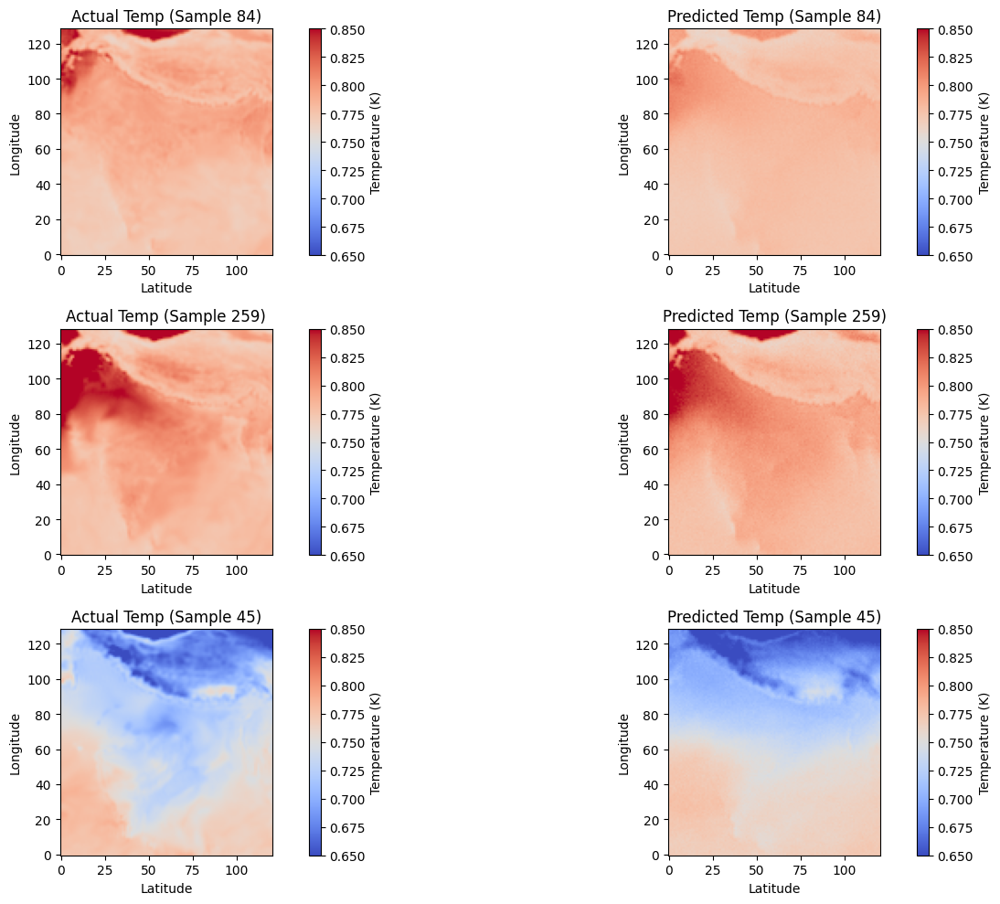

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load the data
actual = np.load('gnn_actuals.npy')       # Shape: (n_samples, 1, lat, lon)
predicted = np.load('gnn_predictions.npy')

# Select 3 random sample indices
np.random.seed(42)  # For reproducibility
sample_indices = np.random.choice(actual.shape[0], size=3, replace=False)

# Fixed color scale
vmin, vmax = 0.65, 0.85

# Plotting
plt.figure(figsize=(15, 10))

for i, idx in enumerate(sample_indices):
    actual_temp = np.rot90(actual[idx, 0].T, k=5)
    predicted_temp = np.rot90(predicted[idx, 0].T, k=5)

    # Actual
    plt.subplot(3, 2, i*2 + 1)
    im1 = plt.imshow(actual_temp, cmap='coolwarm', origin='lower', vmin=vmin, vmax=vmax)
    plt.colorbar(im1, label='Temperature (K)')
    plt.title(f'Actual Temp (Sample {idx})')
    plt.xlabel('Latitude')
    plt.ylabel('Longitude')

    # Predicted
    plt.subplot(3, 2, i*2 + 2)
    im2 = plt.imshow(predicted_temp, cmap='coolwarm', origin='lower', vmin=vmin, vmax=vmax)
    plt.colorbar(im2, label='Temperature (K)')
    plt.title(f'Predicted Temp (Sample {idx})')
    plt.xlabel('Latitude')
    plt.ylabel('Longitude')

plt.tight_layout()
plt.show()


##Animating the result

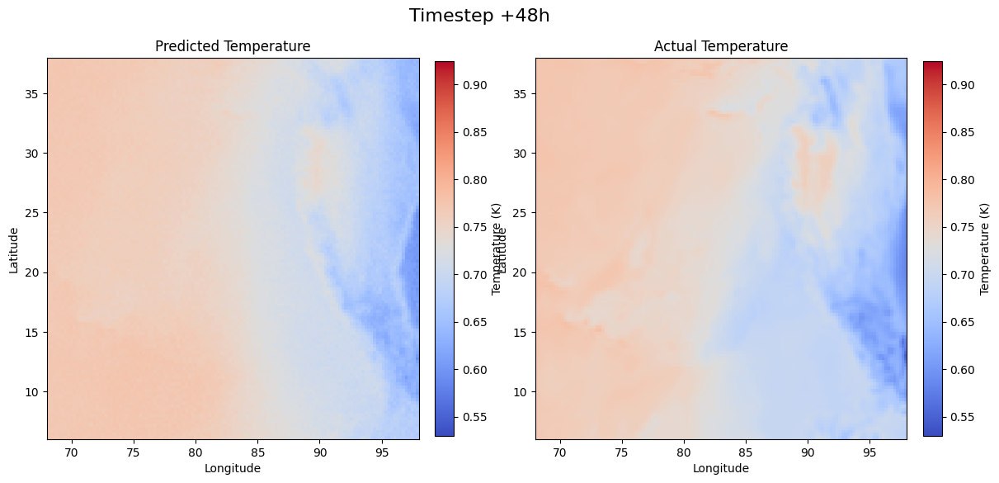

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Load data
predictions = np.load('gnn_predictions.npy')  # shape: (samples, 1, lat, lon)
actuals = np.load('gnn_actuals.npy')
lat = ds.latitude.values
lon = ds.longitude.values

# Parameters
sample_index = 0
num_frames = min(8, len(predictions))  # 8 frames = 48 hours

# Extract sequences
pred_seq = predictions[sample_index:sample_index + num_frames, 0]
actual_seq = actuals[sample_index:sample_index + num_frames, 0]

# Figure setup
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Rotate properly 90° clockwise using np.rot90(..., k=-1)
pred_img = axs[0].imshow(np.rot90(pred_seq[0], k=5), extent=(lon.min(), lon.max(), lat.min(), lat.max()),
                         origin='lower', cmap='coolwarm', aspect='auto',
                         vmin=actuals.min(), vmax=actuals.max())

actual_img = axs[1].imshow(np.rot90(actual_seq[0], k=5), extent=(lon.min(), lon.max(), lat.min(), lat.max()),
                           origin='lower', cmap='coolwarm', aspect='auto',
                           vmin=actuals.min(), vmax=actuals.max())

# Colorbars and labels
plt.colorbar(pred_img, ax=axs[0], fraction=0.046, pad=0.04, label='Temperature (K)')
plt.colorbar(actual_img, ax=axs[1], fraction=0.046, pad=0.04, label='Temperature (K)')
axs[0].set_title("Predicted Temperature")
axs[1].set_title("Actual Temperature")
for ax in axs:
    ax.set_xlabel("Longitude")
    ax.set_ylabel("Latitude")

# Animation update function
def update(frame):
    pred_img.set_data(np.rot90(pred_seq[frame], k=5))
    actual_img.set_data(np.rot90(actual_seq[frame], k=5))
    fig.suptitle(f"Timestep +{(frame+1)*6}h", fontsize=16)
    return [pred_img, actual_img]

ani = animation.FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=True)
HTML(ani.to_jshtml())


##Temp Prediction Error Distribution

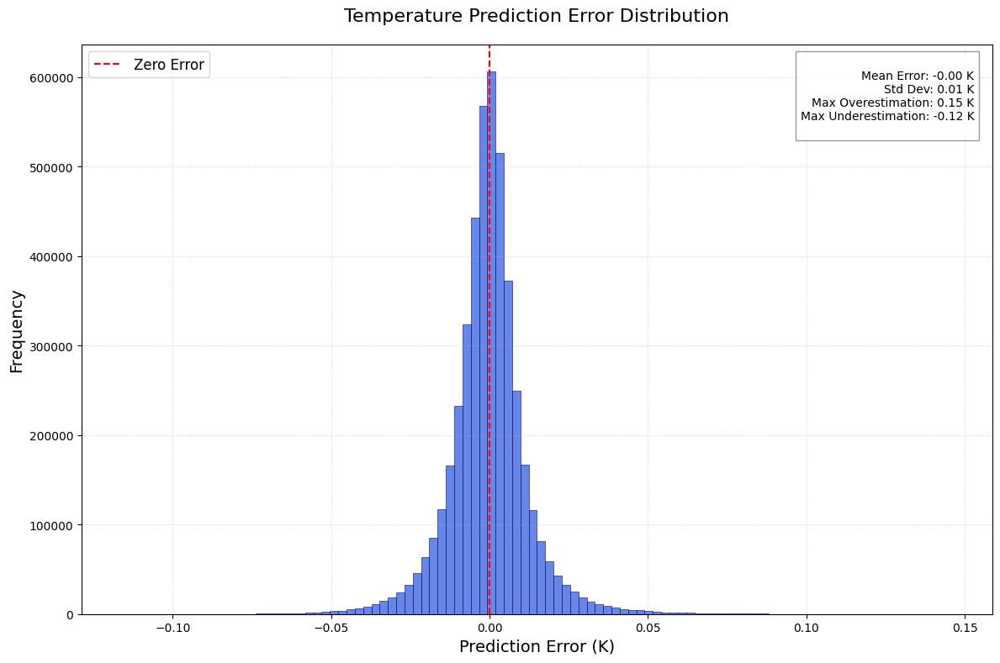

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Load the data
actual = np.load('gnn_actuals.npy')    # Shape: (n_samples, 1, lat, lon)
predicted = np.load('gnn_predictions.npy')  # Shape: (n_samples, 1, lat, lon)

# Calculate errors
errors = predicted - actual  # Shape: (n_samples, 1, lat, lon)
all_errors = errors.flatten()  # Flatten all errors into 1D array

# Create figure with larger size
plt.figure(figsize=(12, 8))

# Plot histogram with enhanced styling
n, bins, patches = plt.hist(
    all_errors,
    bins=100,
    color='royalblue',
    edgecolor='navy',
    linewidth=0.5,
    alpha=0.8
)

# Add vertical line at zero
plt.axvline(0, color='red', linestyle='--', linewidth=1.5, label='Zero Error')

# Customize plot
plt.title('Temperature Prediction Error Distribution', fontsize=16, pad=20)
plt.xlabel('Prediction Error (K)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.grid(True, linestyle=':', alpha=0.5)

# Add statistics box
stats_text = f"""
Mean Error: {np.mean(all_errors):.2f} K
Std Dev: {np.std(all_errors):.2f} K
Max Overestimation: {np.max(all_errors):.2f} K
Max Underestimation: {np.min(all_errors):.2f} K
"""
plt.text(
    0.98, 0.98, stats_text,
    transform=plt.gca().transAxes,
    verticalalignment='top',
    horizontalalignment='right',
    bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray')
)

plt.legend(fontsize=12)
plt.tight_layout()
plt.show()